# 1. Importing Libraries.

In [1]:
# Importing Libraries
import numpy as np
import pandas as pd

# EDA
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

# Pre-processing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

#Clustering
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans

import matplotlib.patheffects as path_effects
from matplotlib import colors
from matplotlib.colors import ListedColormap
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go

from sklearn.cluster import AgglomerativeClustering

# SVM
from sklearn import svm
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report

from sklearn.metrics import accuracy_score,confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score

#Sweetviz report
import sweetviz as sv

# Pandas profile
from pandas_profiling import ProfileReport

# Avoid warnings
import warnings
warnings.simplefilter("ignore")

# 2. Loading the data set

In [2]:
# Load data
df = pd.read_csv("D:\DATA SCIENCE\Project\Customer Personality Analysis\Dataset.csv")

### Information about the data set

# 3. EDA

In [3]:
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0


In [4]:
df.shape

(2240, 29)

### Pandas Profile Report:

In [5]:
pr = ProfileReport(df)
pr

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
# report by sweetviz

my_report = sv.analyze(df)
my_report.show_html()

                                             |                                             | [  0%]   00:00 ->…

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [7]:
df.sample(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
373,1245,1966,Graduation,Single,63810.0,0,1,11-11-2012,45,977,...,8,0,1,0,0,0,0,3,11,0
530,702,1975,2n Cycle,Widow,47682.0,0,1,15-02-2013,80,162,...,5,0,0,0,0,0,0,3,11,0
1485,9988,1976,Master,Single,70379.0,0,1,03-03-2013,84,553,...,4,0,0,0,0,0,0,3,11,0
840,4186,1950,Graduation,Together,34026.0,1,1,05-08-2013,11,18,...,5,0,0,0,0,0,0,3,11,0
1285,5267,1970,Graduation,Divorced,33986.0,1,0,14-03-2013,43,16,...,7,0,0,0,0,0,0,3,11,0


In [8]:
# set up to view all the info of the columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [9]:
df.sample(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
79,1618,1965,Graduation,Together,56046.0,0,0,02-01-2013,9,577,0,64,0,0,51,2,10,1,8,8,1,0,0,0,0,0,3,11,1
1206,7789,1965,PhD,Married,84618.0,0,0,22-11-2013,96,684,100,801,21,66,0,1,6,9,10,2,0,0,1,0,0,0,3,11,0
113,999,1991,Graduation,Single,86037.0,0,0,02-01-2013,95,490,44,125,29,20,22,1,6,7,11,3,0,1,1,0,0,0,3,11,1
1361,1384,1992,Basic,Married,17256.0,1,0,23-11-2013,10,6,4,14,8,8,22,2,2,1,2,8,1,0,0,0,0,0,3,11,0
1537,10530,1959,PhD,Widow,67786.0,0,0,07-12-2013,0,431,82,441,80,20,102,1,3,6,6,1,0,0,0,0,0,0,3,11,1


In [10]:
options = ['Graduation' ,'PhD'] 
    
# selecting rows based on condition 
rslt_df = df[(df['ID'] == 4141) & 
          df['Education'].isin(options)] 
    
print('\nResult dataframe :\n',
      rslt_df)


Result dataframe :
      ID  Year_Birth   Education Marital_Status   Income  Kidhome  Teenhome  \
2  4141        1965  Graduation       Together  71613.0        0         0   

  Dt_Customer  Recency  MntWines  MntFruits  MntMeatProducts  MntFishProducts  \
2  21-08-2013       26       426         49              127              111   

   MntSweetProducts  MntGoldProds  NumDealsPurchases  NumWebPurchases  \
2                21            42                  1                8   

   NumCatalogPurchases  NumStorePurchases  NumWebVisitsMonth  AcceptedCmp3  \
2                    2                 10                  4             0   

   AcceptedCmp4  AcceptedCmp5  AcceptedCmp1  AcceptedCmp2  Complain  \
2             0             0             0             0         0   

   Z_CostContact  Z_Revenue  Response  
2              3         11         0  


In [11]:
def basic_info(df):
    print("This dfset has ", df.shape[1], " columns and ", df.shape[0], " rows.")
    print("This dfset has ", df[df.duplicated()].shape[0], " duplicated rows.")
    print(" ")
    print("Descriptive statistics of the numeric features in the dfset: ")
    print(" ")
    print(df.describe())
    print(" ")
    print("Information about this dfset: ")
    print(" ")
    print(df.info())

In [12]:
basic_info(df)

This dfset has  29  columns and  2240  rows.
This dfset has  0  duplicated rows.
 
Descriptive statistics of the numeric features in the dfset: 
 
                 ID   Year_Birth         Income      Kidhome     Teenhome  \
count   2240.000000  2240.000000    2216.000000  2240.000000  2240.000000   
mean    5592.159821  1968.805804   52247.251354     0.444196     0.506250   
std     3246.662198    11.984069   25173.076661     0.538398     0.544538   
min        0.000000  1893.000000    1730.000000     0.000000     0.000000   
25%     2828.250000  1959.000000   35303.000000     0.000000     0.000000   
50%     5458.500000  1970.000000   51381.500000     0.000000     0.000000   
75%     8427.750000  1977.000000   68522.000000     1.000000     1.000000   
max    11191.000000  1996.000000  666666.000000     2.000000     2.000000   

           Recency     MntWines    MntFruits  MntMeatProducts  \
count  2240.000000  2240.000000  2240.000000      2240.000000   
mean     49.109375   303.9357

In [13]:
df.median()

ID                      5458.5
Year_Birth              1970.0
Income                 51381.5
Kidhome                    0.0
Teenhome                   0.0
Recency                   49.0
MntWines                 173.5
MntFruits                  8.0
MntMeatProducts           67.0
MntFishProducts           12.0
MntSweetProducts           8.0
MntGoldProds              24.0
NumDealsPurchases          2.0
NumWebPurchases            4.0
NumCatalogPurchases        2.0
NumStorePurchases          5.0
NumWebVisitsMonth          6.0
AcceptedCmp3               0.0
AcceptedCmp4               0.0
AcceptedCmp5               0.0
AcceptedCmp1               0.0
AcceptedCmp2               0.0
Complain                   0.0
Z_CostContact              3.0
Z_Revenue                 11.0
Response                   0.0
dtype: float64

In [14]:
df_copy = df.copy()

In [15]:
# Divide the data into two dataframes: one has income values, and the other doesn't.
have_income = df_copy[df_copy.Income.isnull()== False]
missing_income = df_copy[df_copy.Income.isnull()== True]

In [16]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [17]:
# Convert the one that has income to int type
have_income.Income = have_income.Income.astype('int64')

# Give a string value of "0" to missing value, then we can convert it into int type
missing_income.Income = str(have_income.Income.median())

# Coverting String and Float dtypes to int dtype
missing_income.Income = missing_income.Income.str.replace(".5", "")
missing_income.Income = missing_income.Income.astype('int64')

In [18]:
# Combine the data
df_copy = missing_income.append(have_income)

In [19]:
options = ['Graduation' ,'PhD','2n Cycle','Master'] 
    
# selecting rows based on condition 
rslt_df = df_copy[(df_copy['ID'] == 5250) & 
          df_copy['Education'].isin(options)] 
    
print('\nResult dataframe :\n',
      rslt_df)


Result dataframe :
         ID  Year_Birth Education Marital_Status  Income  Kidhome  Teenhome  \
2084  5250        1943    Master          Widow   51381        0         0   

     Dt_Customer  Recency  MntWines  MntFruits  MntMeatProducts  \
2084  30-10-2013       75       532        126              490   

      MntFishProducts  MntSweetProducts  MntGoldProds  NumDealsPurchases  \
2084              164               126           126                  1   

      NumWebPurchases  NumCatalogPurchases  NumStorePurchases  \
2084                5                    5                 11   

      NumWebVisitsMonth  AcceptedCmp3  AcceptedCmp4  AcceptedCmp5  \
2084                  1             0             0             1   

      AcceptedCmp1  AcceptedCmp2  Complain  Z_CostContact  Z_Revenue  Response  
2084             0             0         0              3         11         1  


In [20]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2240 entries, 10 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   ID                   2240 non-null   int64 
 1   Year_Birth           2240 non-null   int64 
 2   Education            2240 non-null   object
 3   Marital_Status       2240 non-null   object
 4   Income               2240 non-null   int64 
 5   Kidhome              2240 non-null   int64 
 6   Teenhome             2240 non-null   int64 
 7   Dt_Customer          2240 non-null   object
 8   Recency              2240 non-null   int64 
 9   MntWines             2240 non-null   int64 
 10  MntFruits            2240 non-null   int64 
 11  MntMeatProducts      2240 non-null   int64 
 12  MntFishProducts      2240 non-null   int64 
 13  MntSweetProducts     2240 non-null   int64 
 14  MntGoldProds         2240 non-null   int64 
 15  NumDealsPurchases    2240 non-null   int64 
 16  NumWe

### Issue regarding date 

In [21]:
# This function converts a scalar, array-like, Series or DataFrame/dict-like to a pandas datetime object.
df_copy.Dt_Customer = pd.to_datetime(df_copy.Dt_Customer)

In [22]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2240 entries, 10 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2240 non-null   int64         
 1   Year_Birth           2240 non-null   int64         
 2   Education            2240 non-null   object        
 3   Marital_Status       2240 non-null   object        
 4   Income               2240 non-null   int64         
 5   Kidhome              2240 non-null   int64         
 6   Teenhome             2240 non-null   int64         
 7   Dt_Customer          2240 non-null   datetime64[ns]
 8   Recency              2240 non-null   int64         
 9   MntWines             2240 non-null   int64         
 10  MntFruits            2240 non-null   int64         
 11  MntMeatProducts      2240 non-null   int64         
 12  MntFishProducts      2240 non-null   int64         
 13  MntSweetProducts     2240 non-nu

### Reset the index

In [23]:
# Reset the index
df_1 = df_copy.reset_index(drop=True)

In [24]:
df_1.sample(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
429,4216,1981,Graduation,Single,91065,0,0,2013-02-22,33,822,114,108,179,137,114,1,7,9,9,3,0,0,1,1,0,0,3,11,1
594,5123,1951,Master,Married,27450,0,0,2013-04-15,57,37,12,23,8,11,52,1,2,1,3,7,0,0,0,0,0,0,3,11,0
2016,832,1966,PhD,Together,65814,0,1,2014-02-03,90,561,14,113,10,14,35,3,8,2,10,5,0,0,0,0,0,0,3,11,0
41,6565,1949,Master,Married,76995,0,1,2013-03-28,91,1012,80,498,0,16,176,2,11,4,9,5,0,0,0,1,0,0,3,11,0
148,1685,1967,PhD,Together,62981,0,0,2013-03-17,21,796,14,590,38,44,0,1,4,5,13,3,0,1,0,0,0,0,3,11,0


In [25]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2240 non-null   int64         
 1   Year_Birth           2240 non-null   int64         
 2   Education            2240 non-null   object        
 3   Marital_Status       2240 non-null   object        
 4   Income               2240 non-null   int64         
 5   Kidhome              2240 non-null   int64         
 6   Teenhome             2240 non-null   int64         
 7   Dt_Customer          2240 non-null   datetime64[ns]
 8   Recency              2240 non-null   int64         
 9   MntWines             2240 non-null   int64         
 10  MntFruits            2240 non-null   int64         
 11  MntMeatProducts      2240 non-null   int64         
 12  MntFishProducts      2240 non-null   int64         
 13  MntSweetProducts     2240 non-nul

### Visualizations -

### Finding and Treating the outliers

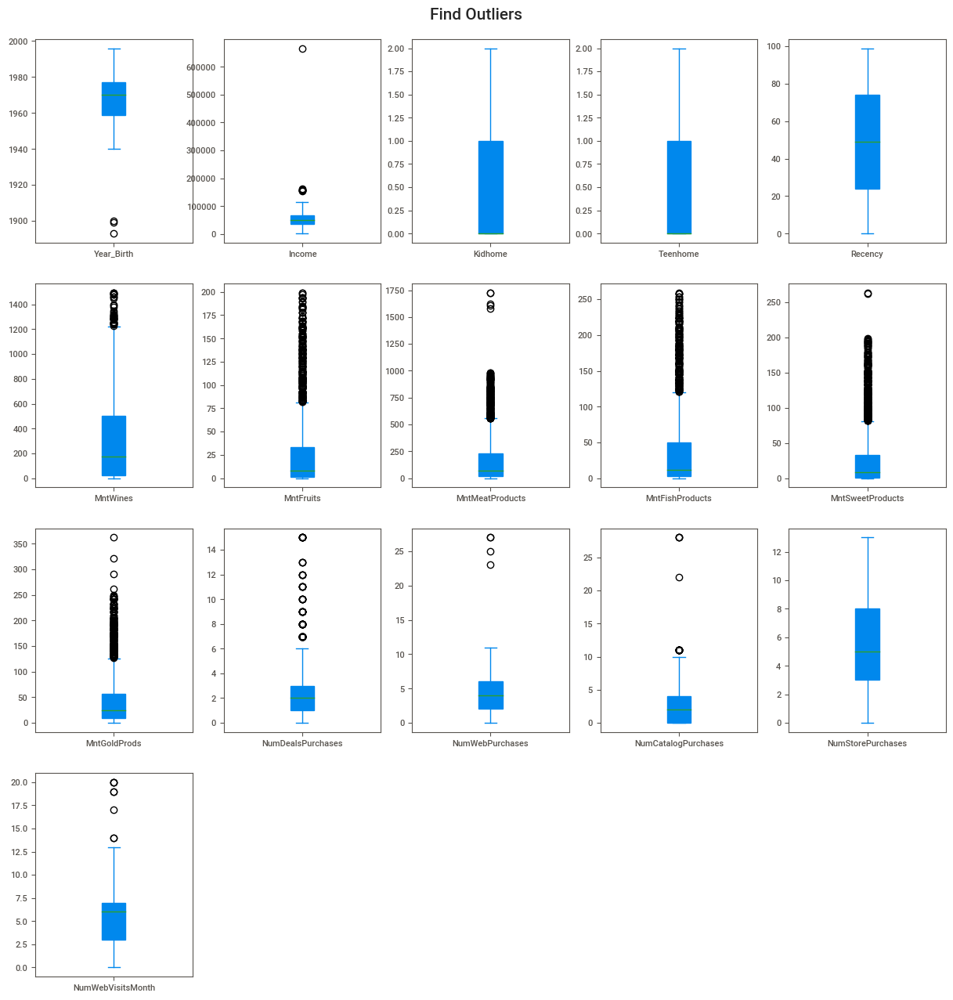

In [26]:
# select columns to plot
# Dropping the categorical columns/ un-useful columns(ID) --> to plot outliers
df_1_to_plot = df_1.drop(columns=['ID', 'AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response', 'Complain','Z_CostContact','Z_Revenue']).select_dtypes(include=np.number)

# subplots: layout=(rows,columns) ; kind='Type of boxblot' ; patch_artist=True (To fill the boxplot with colour)
df_1_to_plot.plot(subplots=True, layout=(5,5), kind='box', figsize=(15,20), patch_artist=True)

plt.suptitle('Find Outliers', fontsize=15, y=0.9)
plt.savefig('boxplots.png', bbox_inches='tight')

* Treating outliers (using emperical formula (µ - 3σ) )

In [27]:
df_1.Year_Birth.describe()

count    2240.000000
mean     1968.805804
std        11.984069
min      1893.000000
25%      1959.000000
50%      1970.000000
75%      1977.000000
max      1996.000000
Name: Year_Birth, dtype: float64

In [28]:
# Remove outliers in year_birth -->(µ - 3σ)

df_1 = df_1[df_1.Year_Birth >= (df_1.Year_Birth.mean()-3*df_1.Year_Birth.std())]
df_1.Year_Birth.describe()

count    2237.000000
mean     1968.901654
std        11.701917
min      1940.000000
25%      1959.000000
50%      1970.000000
75%      1977.000000
max      1996.000000
Name: Year_Birth, dtype: float64

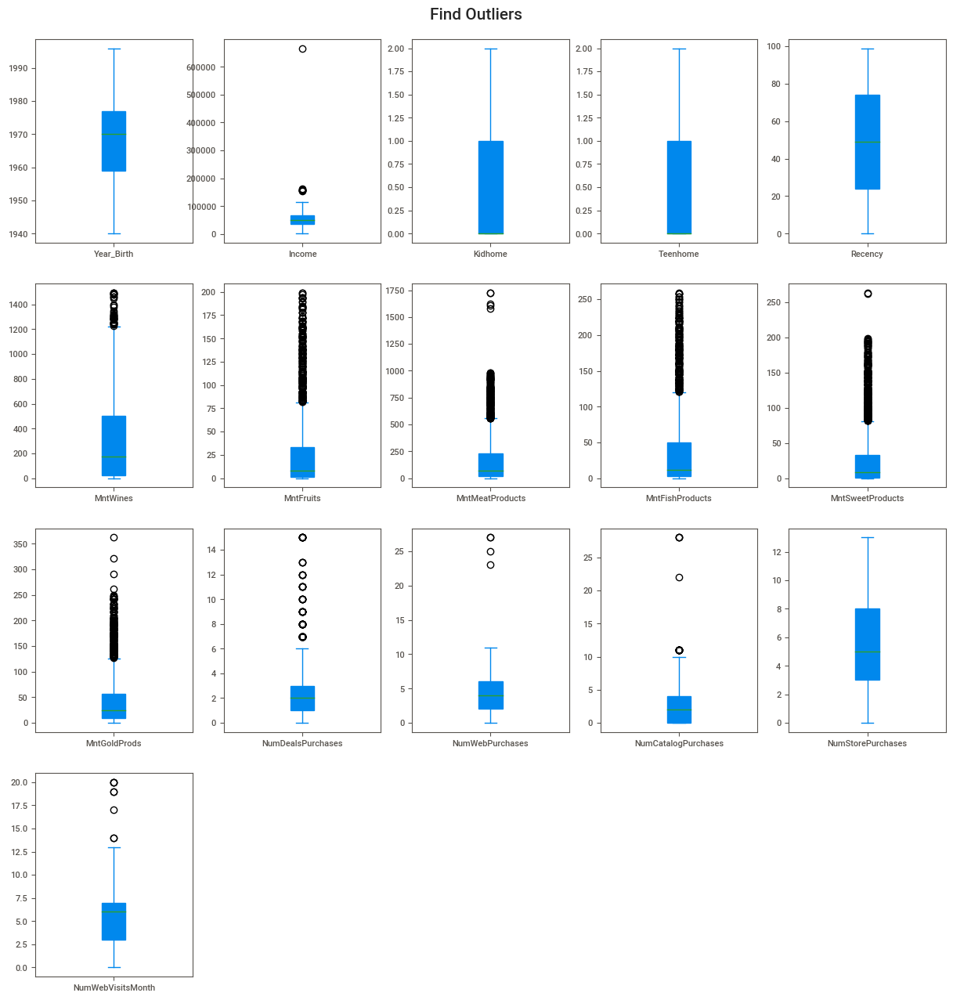

In [29]:
# Outliers after treating on them
df_1_to_plot = df_1.drop(columns=['ID', 'AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response', 'Complain','Z_CostContact','Z_Revenue']).select_dtypes(include=np.number)

# subplots: layout=(rows,columns) ; kind='Type of boxblot' ; patch_artist=True (To fill the boxplot with colour)
df_1_to_plot.plot(subplots=True, layout=(5,5), kind='box', figsize=(15,20), patch_artist=True)

plt.suptitle('Find Outliers', fontsize=15, y=0.9)
plt.savefig('boxplots.png', bbox_inches='tight')

In [30]:
#Dropping some of the redundant features
to_drop = ["Z_CostContact", "Z_Revenue"]
df_1 = df_1.drop(to_drop, axis=1)

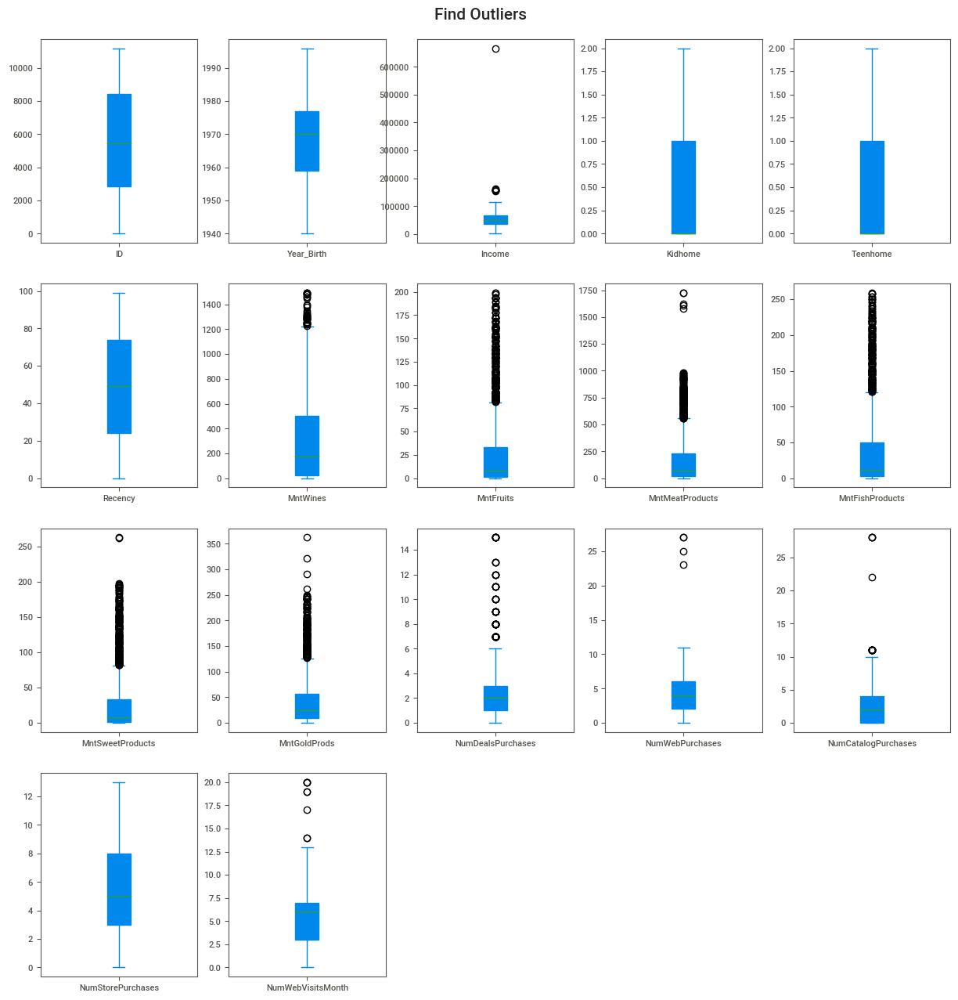

In [31]:
# Outliers after treating on them
df_2_to_plot = df_1.drop(columns=['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response', 'Complain']).select_dtypes(include=np.number)

# subplots: layout=(rows,columns) ; kind='Type of boxblot' ; patch_artist=True (To fill the boxplot with colour)
df_2_to_plot.plot(subplots=True, layout=(5,5), kind='box', figsize=(15,20), patch_artist=True)

plt.suptitle('Find Outliers', fontsize=15, y=0.9)
plt.savefig('boxplots.png', bbox_inches='tight')

In [32]:
#Dropping the outliers by setting a cap on income. 
df_1 =df_1[(df_1["Income"]<600000)]
print("The total number points after removing the outliers are:", len(df_1))

The total number points after removing the outliers are: 2236


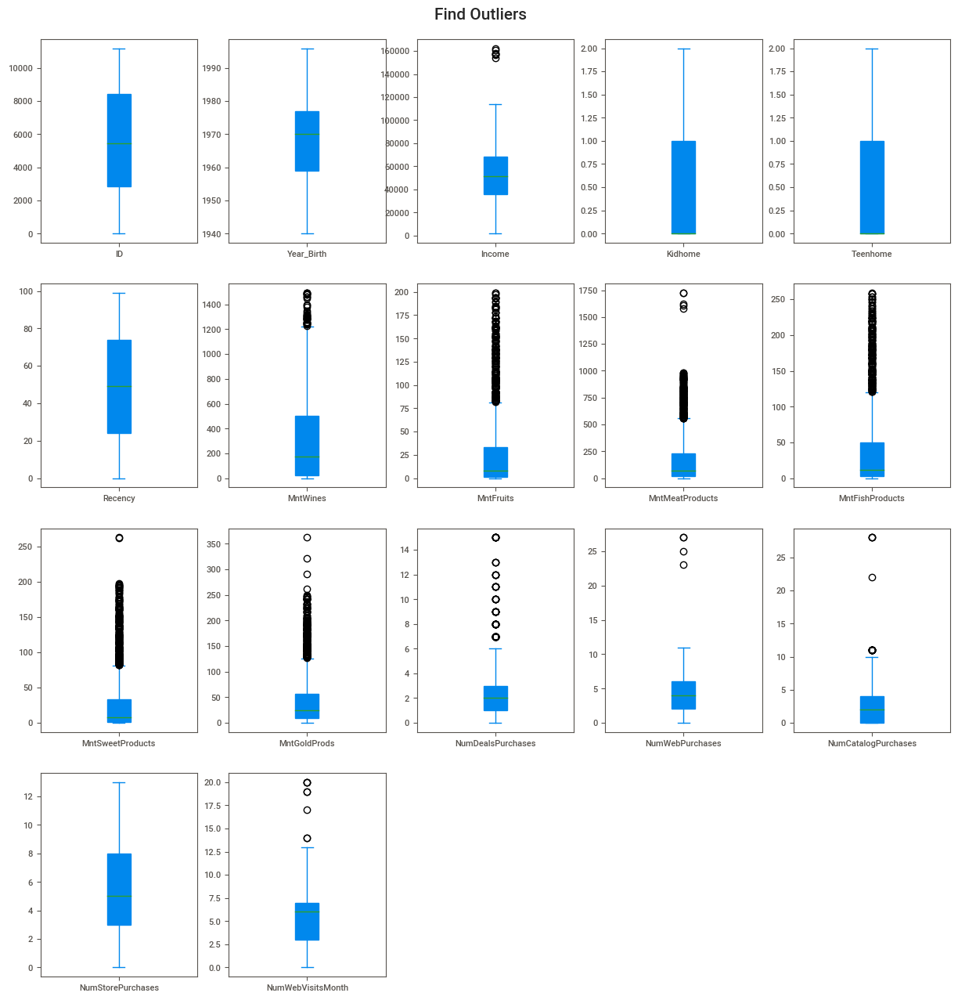

In [33]:
# Outliers after treatting on them
df_2_to_plot = df_1.drop(columns=['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Response', 'Complain']).select_dtypes(include=np.number)

# subplots: layout=(rows,columns) ; kind='Type of boxblot' ; patch_artist=True (To fill the boxplot with colour)
df_2_to_plot.plot(subplots=True, layout=(5,5), kind='box', figsize=(15,20), patch_artist=True)

plt.suptitle('Find Outliers', fontsize=15, y=0.9)
plt.savefig('boxplots.png', bbox_inches='tight')

In [34]:
df_1.sample(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
1099,5577,1983,Graduation,Together,43776,1,0,2014-03-05,77,8,0,9,2,1,3,1,1,0,2,6,0,0,0,0,0,0,0
1822,2549,1983,PhD,Together,21840,1,0,2013-07-21,80,17,0,9,0,0,1,1,1,0,3,9,0,0,0,0,0,0,0
2150,10609,1962,PhD,Married,42769,0,1,2013-12-10,15,71,0,13,3,1,0,2,1,1,4,4,0,0,0,0,0,0,0
1354,2253,1990,Graduation,Married,18929,0,0,2013-02-16,15,32,0,8,23,4,18,1,1,0,4,6,0,0,0,0,0,0,0
609,6919,1978,2n Cycle,Married,26224,1,0,2013-04-06,39,4,7,15,13,9,15,3,2,1,3,6,0,0,0,0,0,0,0


In [35]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2236 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2236 non-null   int64         
 1   Year_Birth           2236 non-null   int64         
 2   Education            2236 non-null   object        
 3   Marital_Status       2236 non-null   object        
 4   Income               2236 non-null   int64         
 5   Kidhome              2236 non-null   int64         
 6   Teenhome             2236 non-null   int64         
 7   Dt_Customer          2236 non-null   datetime64[ns]
 8   Recency              2236 non-null   int64         
 9   MntWines             2236 non-null   int64         
 10  MntFruits            2236 non-null   int64         
 11  MntMeatProducts      2236 non-null   int64         
 12  MntFishProducts      2236 non-null   int64         
 13  MntSweetProducts     2236 non-nul

<AxesSubplot:>

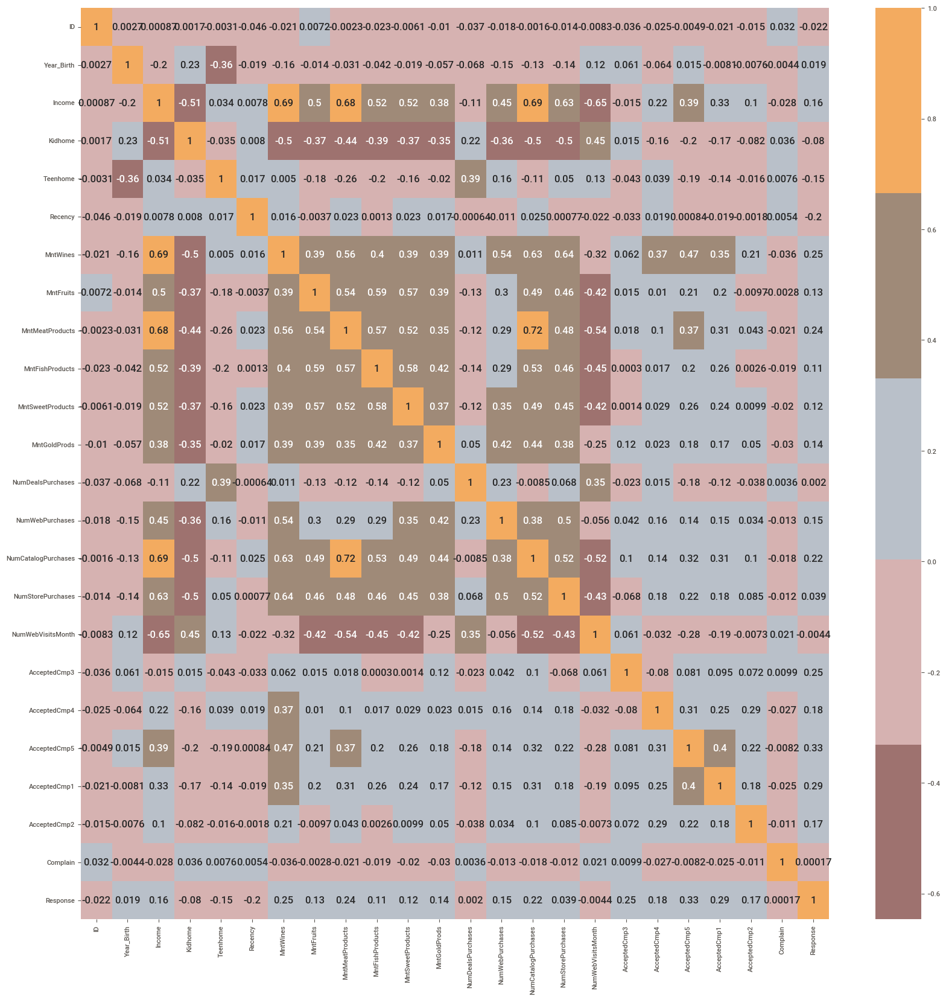

In [36]:
#correlation matrix

cmap =ListedColormap(["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"])

corrmat= df_1.corr()
plt.figure(figsize=(20,20))  
sns.heatmap(corrmat,annot=True, cmap=cmap, center=0)

In [37]:
# Run discriptive statistics of numerical datatypes.
df_1.describe(include = ['float64','int64'])

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
count,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.00000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000
mean,5589.008497,1968.898032,51952.608676,0.444097,0.506708,49.116279,304.12746,26.275939,166.983453,37.536225,27.080501,43.983005,2.326029,4.087657,2.663238,5.795617,5.318873,0.072898,0.074687,0.072451,0.064401,0.013417,0.008945,0.149374
std,3244.826887,11.703281,21411.466994,0.538459,0.544609,28.957284,336.59181,39.724007,225.689645,54.648562,41.299504,52.061568,1.933032,2.779988,2.923898,3.251129,2.426886,0.260027,0.262944,0.259291,0.245520,0.115077,0.094173,0.356536
min,0.000000,1940.000000,1730.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2828.250000,1959.000000,35502.500000,0.000000,0.000000,24.000000,24.00000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,5454.500000,1970.000000,51381.000000,0.000000,0.000000,49.000000,174.00000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,8421.750000,1977.000000,68275.750000,1.000000,1.000000,74.000000,504.25000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,11191.000000,1996.000000,162397.000000,2.000000,2.000000,99.000000,1493.00000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


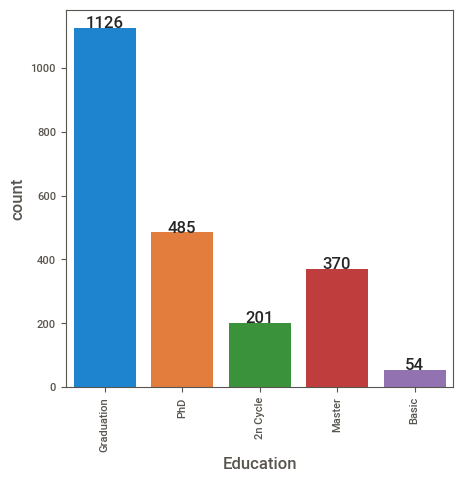

In [38]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Education', data=df_1)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

## Analysis -

In [39]:
#Feature Engineering
#Age of customer today 
df_1["Age"] = 2021-df_1["Year_Birth"]

#Total spendings on various items
df_1["Total_Spent"] = df_1["MntWines"]+ df_1["MntFruits"]+ df_1["MntMeatProducts"]+ df_1["MntFishProducts"]+ df_1["MntSweetProducts"]+ df_1["MntGoldProds"]

#Deriving living situation by marital status"Alone"
df_1["Living_With"]=df_1["Marital_Status"].replace({"Married":"Partner", "Together":"Partner", "Absurd":"Alone", "Widow":"Alone", "YOLO":"Alone", "Divorced":"Alone", "Single":"Alone",})

#Feature indicating total children living in the household
df_1["Children"]=df_1["Kidhome"]+df_1["Teenhome"]

#Feature for total members in the householde
df_1["Family_Size"] = df_1["Living_With"].replace({"Alone": 1, "Partner":2})+ df_1["Children"]

#Feature pertaining parenthood
df_1["Is_Parent"] = np.where(df_1.Children> 0, 1, 0)

#Segmenting education levels in three groups
df_1["Education"]=df_1["Education"].replace({"Basic":"Undergraduate","2n Cycle":"Undergraduate", "Graduation":"Graduate", "Master":"Postgraduate", "PhD":"Postgraduate"})

#For clarity
df_1=df_1.rename(columns={"MntWines": "Wines","MntFruits":"Fruits","MntMeatProducts":"Meat","MntFishProducts":"Fish","MntSweetProducts":"Sweets","MntGoldProds":"Gold"})



In [40]:
df_1["Join_year"] = df_1.Dt_Customer.dt.year
df_1["Join_month"] = df_1.Dt_Customer.dt.month
df_1["Join_weekday"] = df_1.Dt_Customer.dt.weekday

df_1['Total_num_purchase'] = df_1.NumDealsPurchases+ df_1.NumWebPurchases+ df_1.NumCatalogPurchases+ df_1.NumStorePurchases+ df_1.NumWebVisitsMonth 
df_1['Total_accept'] = df_1.AcceptedCmp1 + df_1.AcceptedCmp2 + df_1.AcceptedCmp2 + df_1.AcceptedCmp2  + df_1.AcceptedCmp3 + df_1.AcceptedCmp4 + df_1.AcceptedCmp5 + df_1.Response

In [41]:
# Run discriptive statistics of numerical datatypes.
df_1.describe(include = ['float64','int64'])

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,Wines,Fruits,Meat,Fish,Sweets,Gold,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Total_Spent,Children,Family_Size,Join_year,Join_month,Join_weekday,Total_num_purchase,Total_accept
count,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.00000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000,2236.000000
mean,5589.008497,1968.898032,51952.608676,0.444097,0.506708,49.116279,304.12746,26.275939,166.983453,37.536225,27.080501,43.983005,2.326029,4.087657,2.663238,5.795617,5.318873,0.072898,0.074687,0.072451,0.064401,0.013417,0.008945,0.149374,52.101968,605.986583,0.950805,2.595707,2013.027728,6.520572,3.021914,20.191413,0.474061
std,3244.826887,11.703281,21411.466994,0.538459,0.544609,28.957284,336.59181,39.724007,225.689645,54.648562,41.299504,52.061568,1.933032,2.779988,2.923898,3.251129,2.426886,0.260027,0.262944,0.259291,0.245520,0.115077,0.094173,0.356536,11.703281,601.865156,0.752204,0.907468,0.684857,3.513608,2.010034,7.291811,1.009019
min,0.000000,1940.000000,1730.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,25.000000,5.000000,0.000000,1.000000,2012.000000,1.000000,0.000000,0.000000,0.000000
25%,2828.250000,1959.000000,35502.500000,0.000000,0.000000,24.000000,24.00000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,44.000000,69.000000,0.000000,2.000000,2013.000000,3.000000,1.000000,14.000000,0.000000
50%,5454.500000,1970.000000,51381.000000,0.000000,0.000000,49.000000,174.00000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,51.000000,396.500000,1.000000,3.000000,2013.000000,6.000000,3.000000,19.000000,0.000000
75%,8421.750000,1977.000000,68275.750000,1.000000,1.000000,74.000000,504.25000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,62.000000,1045.500000,1.000000,3.000000,2013.000000,10.000000,5.000000,25.000000,1.000000
max,11191.000000,1996.000000,162397.000000,2.000000,2.000000,99.000000,1493.00000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,81.000000,2525.000000,3.000000,5.000000,2014.000000,12.000000,6.000000,46.000000,7.000000


In [42]:
df_1["Income"].value_counts()

51381     24
7500      12
35860      4
63841      3
18690      3
39922      3
67445      3
34176      3
18929      3
46098      3
47025      3
48432      3
37760      3
83844      3
80134      3
43776      2
81698      2
35791      2
62807      2
44989      2
62466      2
33039      2
87771      2
15315      2
22419      2
69084      2
19514      2
84169      2
47352      2
71367      2
34935      2
81217      2
72635      2
98777      2
83151      2
38946      2
56962      2
33249      2
41335      2
34824      2
50611      2
86857      2
66476      2
68118      2
22804      2
54690      2
51369      2
58330      2
37070      2
46734      2
73059      2
50616      2
67911      2
66664      2
80124      2
34421      2
59292      2
55212      2
68655      2
35178      2
33996      2
62187      2
63342      2
40321      2
71952      2
22574      2
42386      2
29672      2
38361      2
18701      2
15287      2
37717      2
30372      2
46681      2
56796      2
74293      2
20130      2

### Uni-Variate Analysis

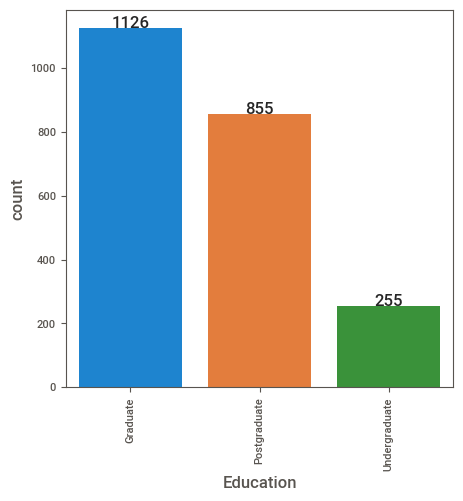

In [43]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Education', data=df_1)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

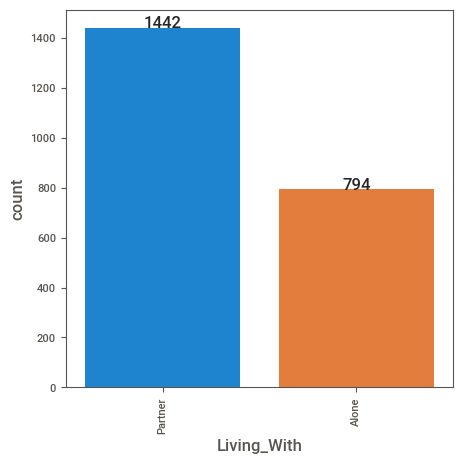

In [44]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Living_With', data=df_1)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

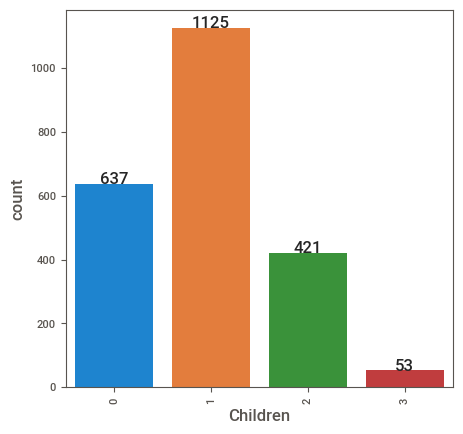

In [45]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Children', data=df_1)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

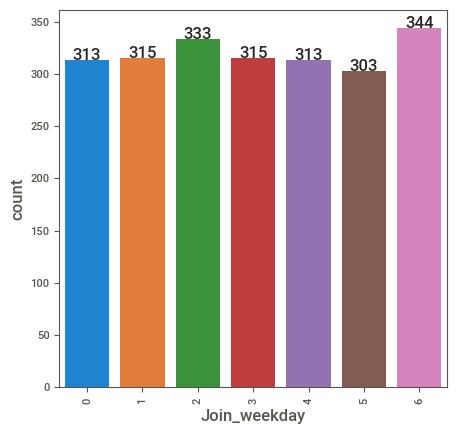

In [46]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Join_weekday', data=df_1)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

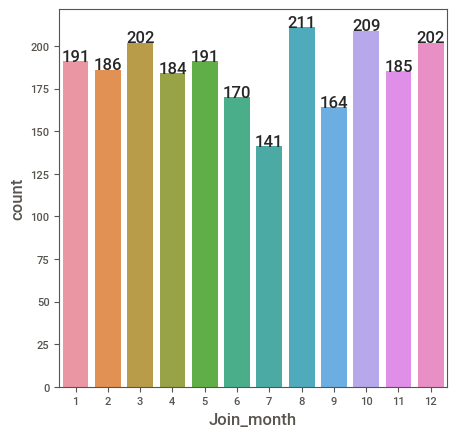

In [47]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Join_month', data=df_1)
graph.set_xticklabels(graph.get_xticklabels())
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

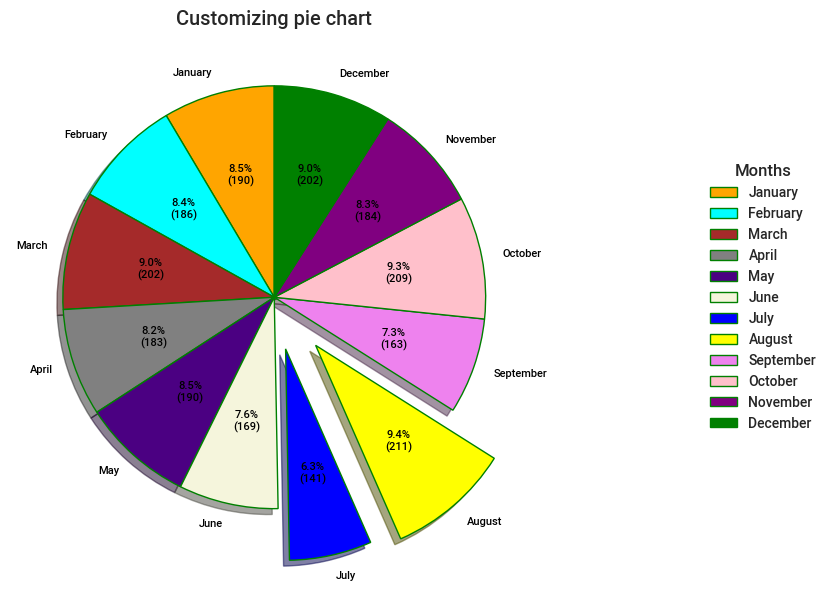

In [48]:
# Creating dataset
months = ["January","February","March","April","May","June","July","August","September","October","November","December"]

data = [191,187,202,184,191,170,141,211,164,209,185,202]


# Creating explode data
explode = (0.0, 0.0, 0.0, 0.0, 0.0, 0.0,0.25,0.3,0.0,0.0,0.0,0.0)

# Creating color parameters
colors = ( "orange", "cyan", "brown","grey", "indigo", "beige","blue","yellow","violet","pink","purple","green")

# Wedge properties
wp = { 'linewidth' : 1, 'edgecolor' : "green" }

# Creating autocpt arguments
def func(pct, allvalues):
    absolute = int(pct / 100.*np.sum(allvalues))
    return "{:.1f}%\n({:d})".format(pct, absolute)

# Creating plot
fig, ax = plt.subplots(figsize =(10, 7))
wedges, texts, autotexts = ax.pie(data,
autopct = lambda pct: func(pct, data),
explode = explode,
labels = months,
shadow = True,
colors = colors,
startangle = 90,
wedgeprops = wp,
textprops = dict(color ="black"))

# Adding legend
ax.legend(wedges, months,
title ="Months",
loc ="center left",
bbox_to_anchor =(1.3, 0, 0.5, 1))

plt.setp(autotexts, size = 8, weight ="bold")
ax.set_title("Customizing pie chart")

# show plot
plt.show()


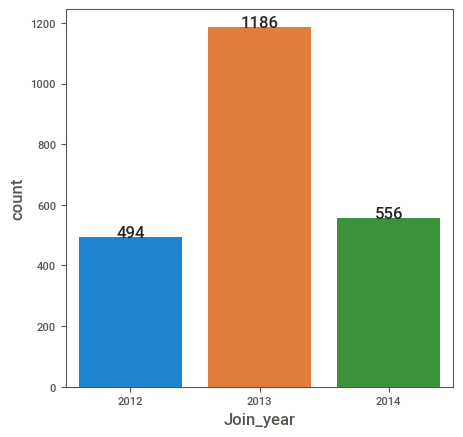

In [49]:
# Lets Display Count on top of countplot

fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Join_year', data=df_1)
graph.set_xticklabels(graph.get_xticklabels())
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")

<AxesSubplot:xlabel='Income', ylabel='Count'>

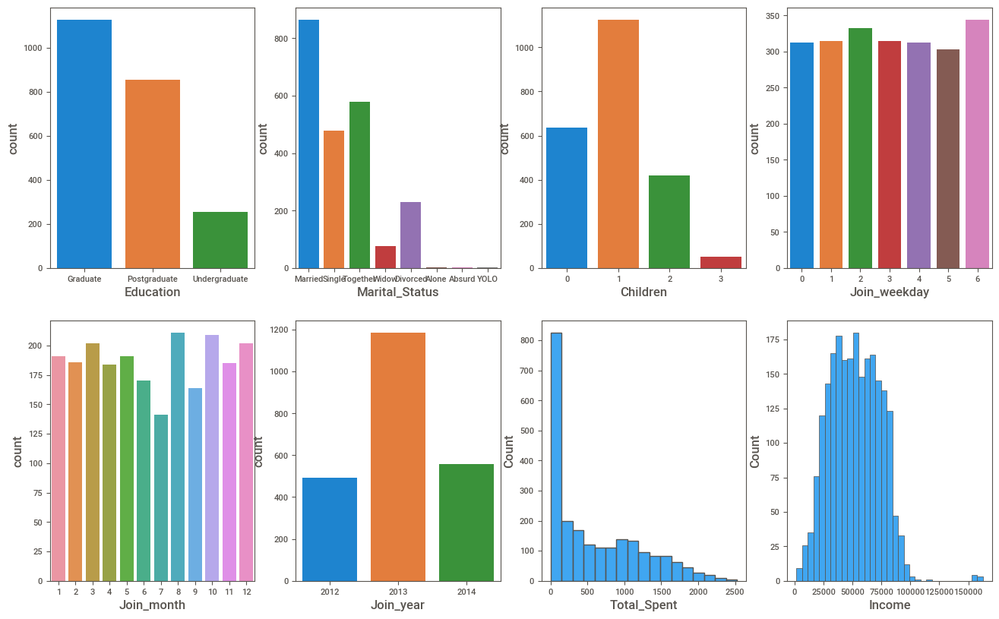

In [50]:
# Combined univariate analysis of each variables
fig,axes = plt.subplots(2,4, figsize=(16,10))
sns.countplot('Education',data=df_1,ax=axes[0,0])
sns.countplot('Marital_Status',data=df_1,ax=axes[0,1])
sns.countplot('Children',data=df_1,ax=axes[0,2])
sns.countplot('Join_weekday',data=df_1,ax=axes[0,3])
sns.countplot('Join_month',data=df_1,ax=axes[1,0])
sns.countplot('Join_year',data=df_1,ax=axes[1,1])

#sns.distplot(df_train['Fare'], kde=True,ax=axes[1,2])
sns.histplot(data=df_1,x="Total_Spent",ax=axes[1,2])
sns.histplot(data=df_1,x="Income",ax=axes[1,3] )


### Bi-Variate Analysis

We perform bi-variate analysis with 2 variables for any combination of categorical and continuous variables.
The combination can be: Categorical & Categorical, Categorical & Continuous and Continuous & Continuous.

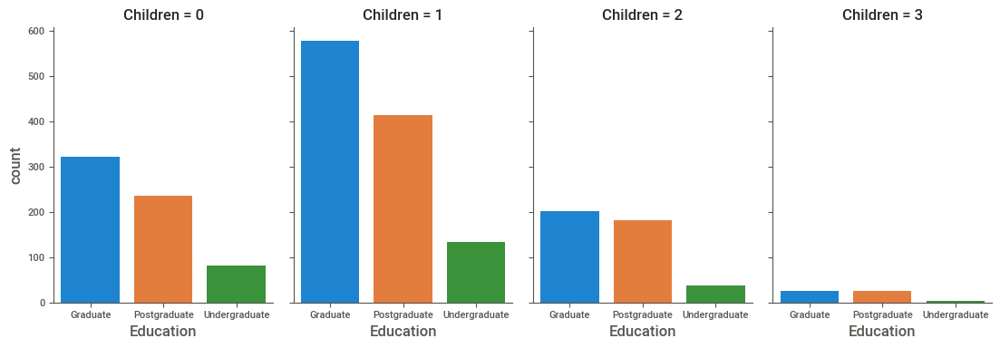

In [51]:
# Lets more elaborate customer behaviour with Education and Income --> use catplot or countplot
'''
fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Education',hue="Minorhome",data=df_1)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")
'''

sns.catplot(x="Education",col="Children",data=df_1, kind="count",height=4, aspect =.7)

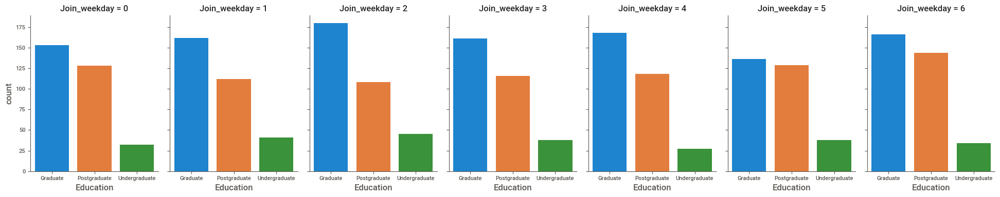

In [52]:
# Lets more elaborate customer behaviour with Education and Income --> use catplot or countplot

sns.catplot(x="Education",col="Join_weekday",data=df_1, kind="count",height=4, aspect =.7)

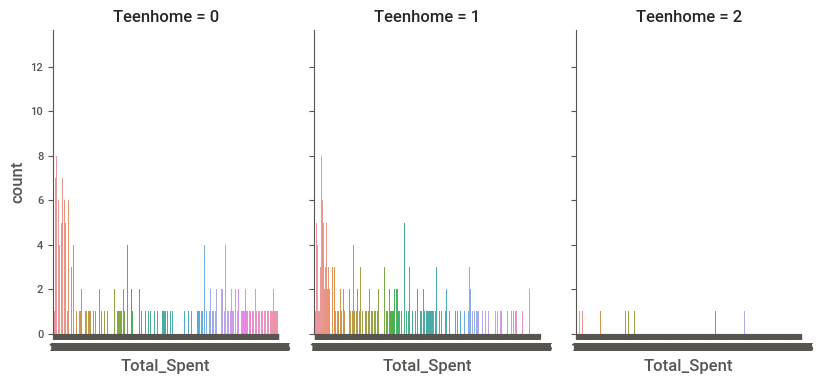

In [53]:
# Lets more elaborate customer behaviour with Teenhome and Total_Spent --> use catplot or countplot
'''
fig, ax1 = plt.subplots(figsize=(5,5))
graph = sns.countplot(ax=ax1,x='Total_Spent',hue="Teenhome",data=new_df)
graph.set_xticklabels(graph.get_xticklabels(),rotation=90)
for p in graph.patches:
    height = p.get_height()
    graph.text(p.get_x()+p.get_width()/2., height + 0.1,height ,ha="center")
'''

sns.catplot(x="Total_Spent",col="Teenhome",data=df_1, kind="count",height=4, aspect =.7)

### Multi-Variate Analysis 

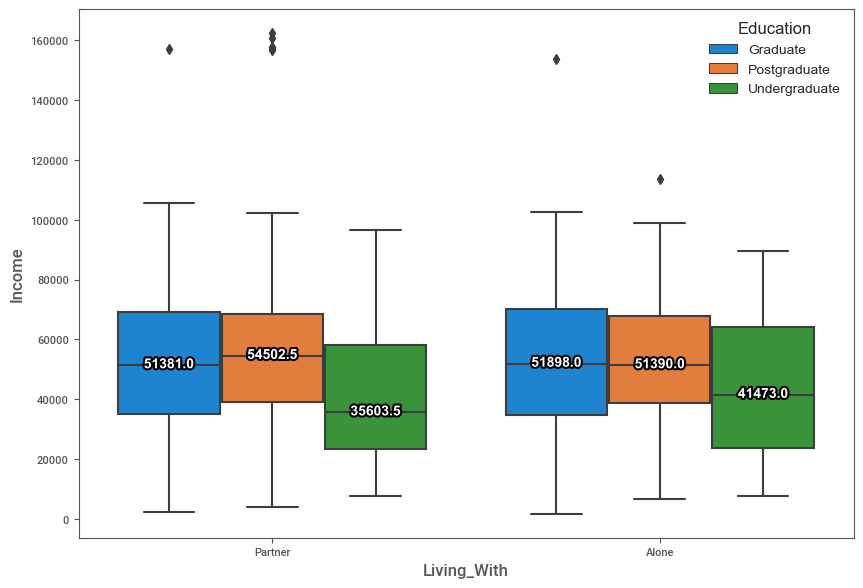

In [54]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = df_1
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Living_With', y='Income', hue='Education', data=df_1,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()

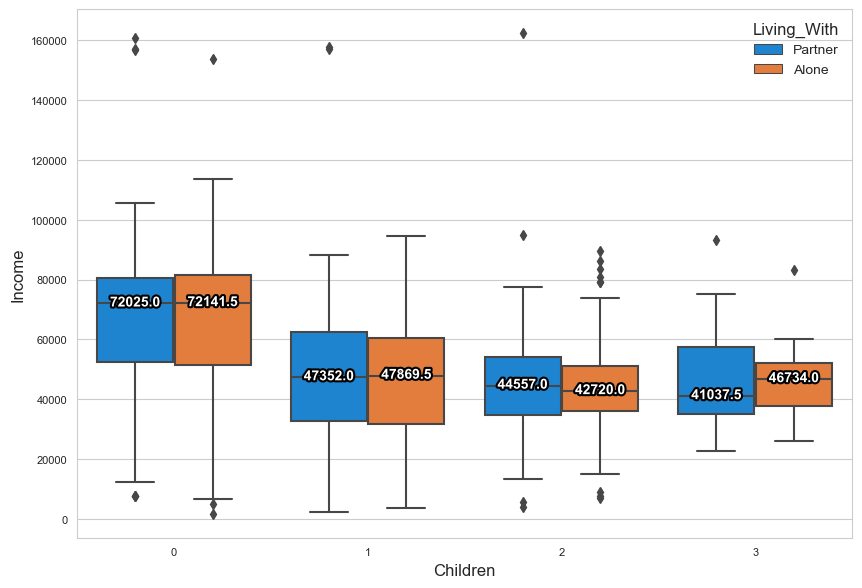

In [55]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = df_1
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Children', y='Income', hue='Living_With', data=df_1,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()

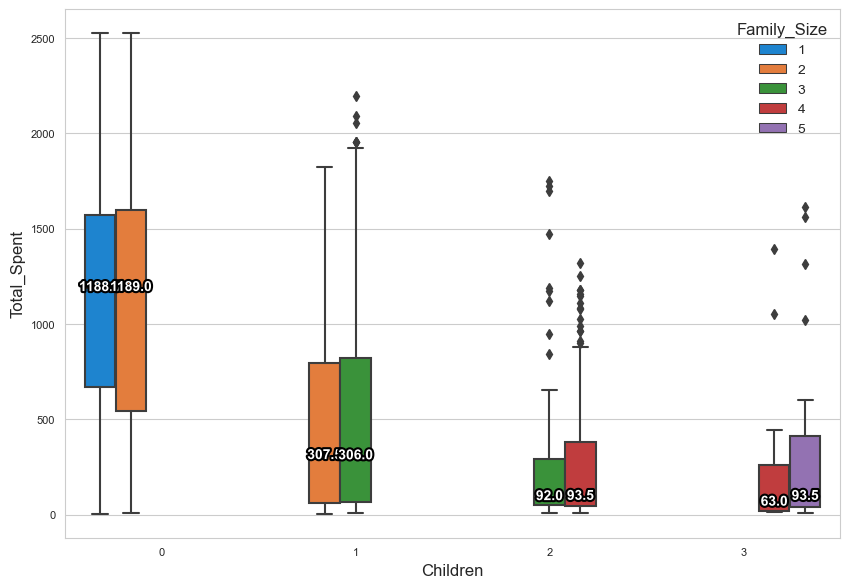

In [56]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = df_1
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Children', y='Total_Spent', hue='Family_Size', data=df_1,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()

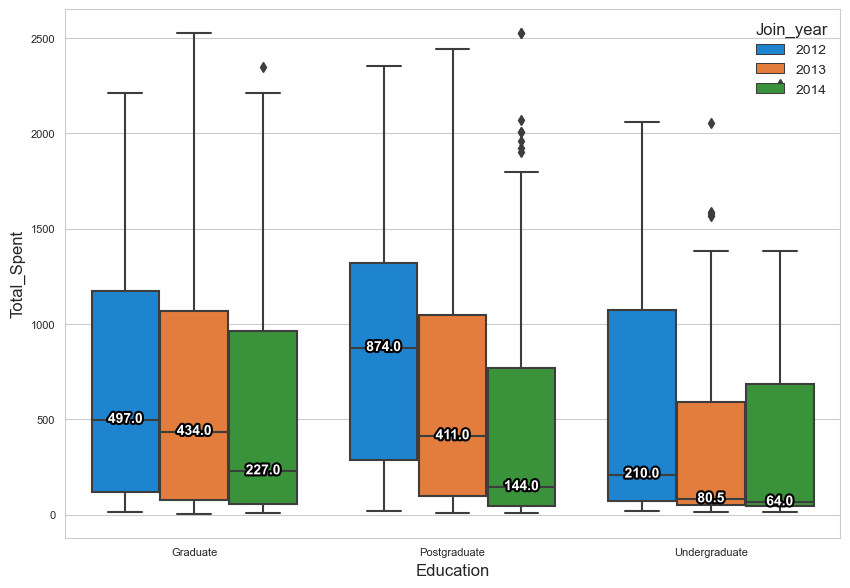

In [57]:
fig, ax1 = plt.subplots(figsize=(10,7))

def main():
    sns.set_style("whitegrid")
    tips = df_1
    # optionally disable fliers
    showfliers = True
    # plot data and create median labels
    box_plot = sns.boxplot(ax=ax1, x='Education', y='Total_Spent', hue='Join_year', data=df_1,
                           showfliers=showfliers)
    create_median_labels(box_plot.axes, showfliers)
    plt.show()


def create_median_labels(ax, has_fliers):
    lines = ax.get_lines()
    # depending on fliers, toggle between 5 and 6 lines per box
    lines_per_box = 5 + int(has_fliers)
    # iterate directly over all median lines, with an interval of lines_per_box
    # this enables labeling of grouped data without relying on tick positions
    for median_line in lines[4:len(lines):lines_per_box]:
        # get center of median line
        mean_x = sum(median_line._x) / len(median_line._x)
        mean_y = sum(median_line._y) / len(median_line._y)
        # print text to center coordinates
        text = ax.text(mean_x, mean_y, f'{mean_y:.1f}',
                       ha='center', va='center',
                       fontweight='bold', size=10, color='white')
        # create small black border around white text
        # for better readability on multi-colored boxes
        text.set_path_effects([
            path_effects.Stroke(linewidth=3, foreground='black'),
            path_effects.Normal(),
        ])


if __name__ == '__main__':
    main()

In [58]:
education = df_1.Education.value_counts()

fig = px.pie(education, 
             values = education.values, 
             names = education.index,
             color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_traces(textposition='inside', textinfo='percent+label', 
                  marker = dict(line = dict(color = 'white', width = 2)))
fig.show()

In [59]:
df_1.loc[(df_1['Age'] >= 13) & (df_1['Age'] <= 19), 'AgeGroup'] = 'Teen'
df_1.loc[(df_1['Age'] >= 20) & (df_1['Age']<= 39), 'AgeGroup'] = 'Adult'
df_1.loc[(df_1['Age'] >= 40) & (df_1['Age'] <= 59), 'AgeGroup'] = 'Middle Age Adult'
df_1.loc[(df_1['Age'] > 60), 'AgeGroup'] = 'Senior Adult'

In [60]:
children = df_1.Children.value_counts()

fig = px.pie(children, 
             values = children.values, 
             names = children.index,
             color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_traces(textposition='inside', textinfo='percent+label', 
                  marker = dict(line = dict(color = 'white', width = 2)))
fig.show()

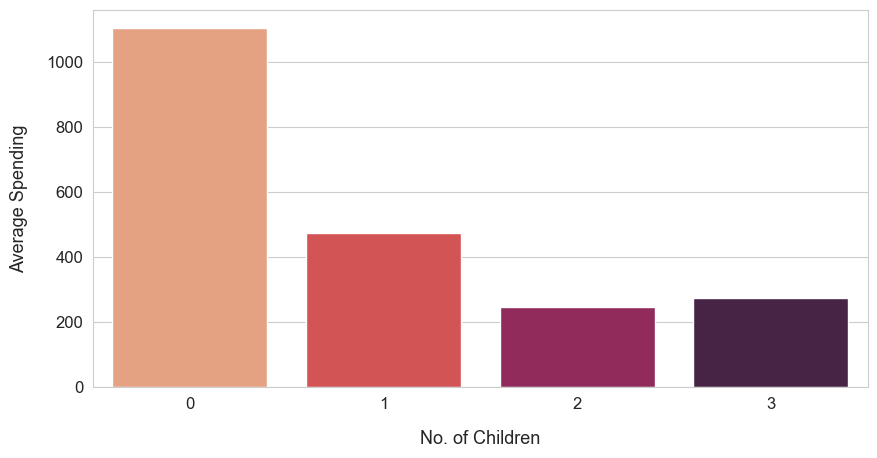

In [61]:
childrenspending = df_1.groupby('Children')['Total_Spent'].mean().sort_values(ascending=False)
childrenspending_df_1 = pd.DataFrame(list(childrenspending.items()), columns=['No. of Children', 'Average Spending'])

plt.figure(figsize=(10,5))

sns.barplot(data=childrenspending_df_1,  x="No. of Children", y="Average Spending", palette='rocket_r');
plt.xticks( fontsize=12)
plt.yticks( fontsize=12)
plt.xlabel('No. of Children', fontsize=13, labelpad=13)
plt.ylabel('Average Spending', fontsize=13, labelpad=13);

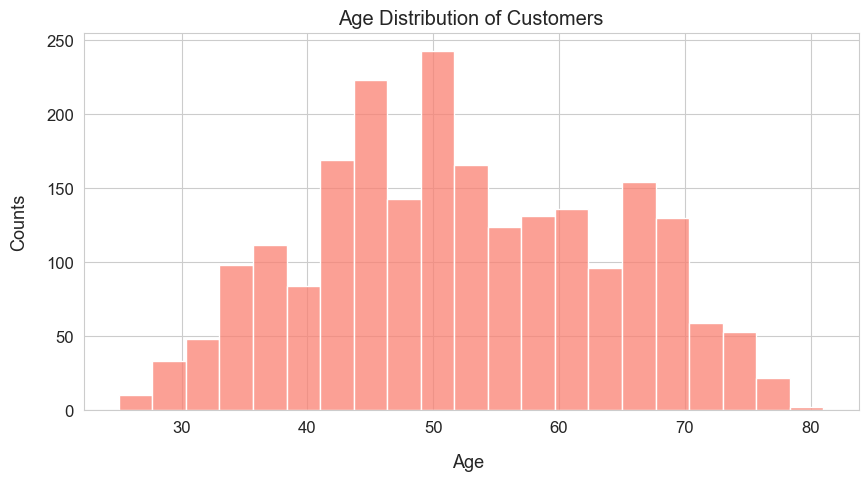

In [62]:
plt.figure(figsize=(10,5))
ax = sns.histplot(data = df_1.Age, color='salmon')
ax.set(title = "Age Distribution of Customers");
plt.xticks( fontsize=12)
plt.yticks( fontsize=12)
plt.xlabel('Age ', fontsize=13, labelpad=13)
plt.ylabel('Counts', fontsize=13, labelpad=13);

In [63]:
def find_IQR(df, column):
  q_25, q_75 = np.quantile(df[column], 0.25), np.quantile(df[column], 0.75)
  IQR = q_75 - q_25
  whiskers_range = IQR * 1.5
  lower, upper = q_25 - whiskers_range, whiskers_range + q_75
  return lower, upper

In [64]:
lower_age, upper_age = find_IQR(df_1, "Age")
print(lower_age, upper_age)

17.0 89.0


In [65]:
lower_income, upper_income = find_IQR(df_1, "Income")
print(lower_income, upper_income)

-13657.375 117435.625


In [66]:
def find_IQR(df_1, column):
  q_25, q_75 = np.quantile(df_1[column], 0.25), np.quantile(df_1[column], 0.75)
  IQR = q_75 - q_25
  whiskers_range = IQR * 1.5
  lower, upper = q_25 - whiskers_range, whiskers_range + q_75
  return lower, upper

In [67]:
# Drop the outliers
df_1 = df_1[(df_1["Age"] < upper_age)]
df_1 = df_1[(df_1["Income"] < upper_income)]

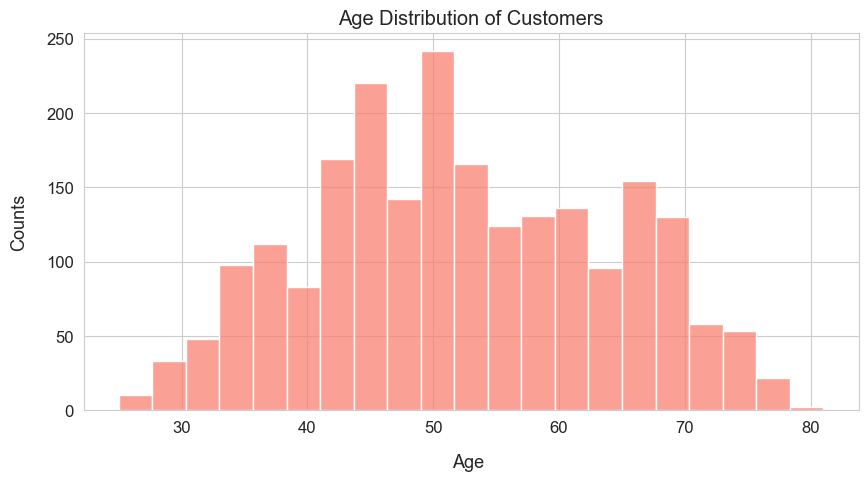

In [68]:
plt.figure(figsize=(10,5))
ax = sns.histplot(data = df_1.Age, color='salmon')
ax.set(title = "Age Distribution of Customers");
plt.xticks( fontsize=12)
plt.yticks( fontsize=12)
plt.xlabel('Age ', fontsize=13, labelpad=13)
plt.ylabel('Counts', fontsize=13, labelpad=13);

The age of customers is almost normally distributed, with the majority of customers between the ages of 40 and 60.

In [69]:
agegroup = df_1.AgeGroup.value_counts()

fig = px.pie(labels = agegroup.index, values = agegroup.values, names = agegroup.index, width = 550, height = 550)

fig.update_traces(textposition = 'inside', 
                  textinfo = 'percent + label', 
                  hole = 0.4, 
                  marker = dict(colors = ['#3D0C02', '#800000'  , '#C11B17','#C0C0C0'], 
                                line = dict(color = 'white', width = 2)))

fig.update_layout(annotations = [dict(text = 'Age Groups', 
                                      x = 0.5, y = 0.5, font_size = 20, showarrow = False,                                       
                                      font_color = 'black')],
                  showlegend = False)

fig.show()

More than 50% of customers are Middle Age Adults between 40 and 60 The 2nd well-known age category is Adults, aged between 20 and 40

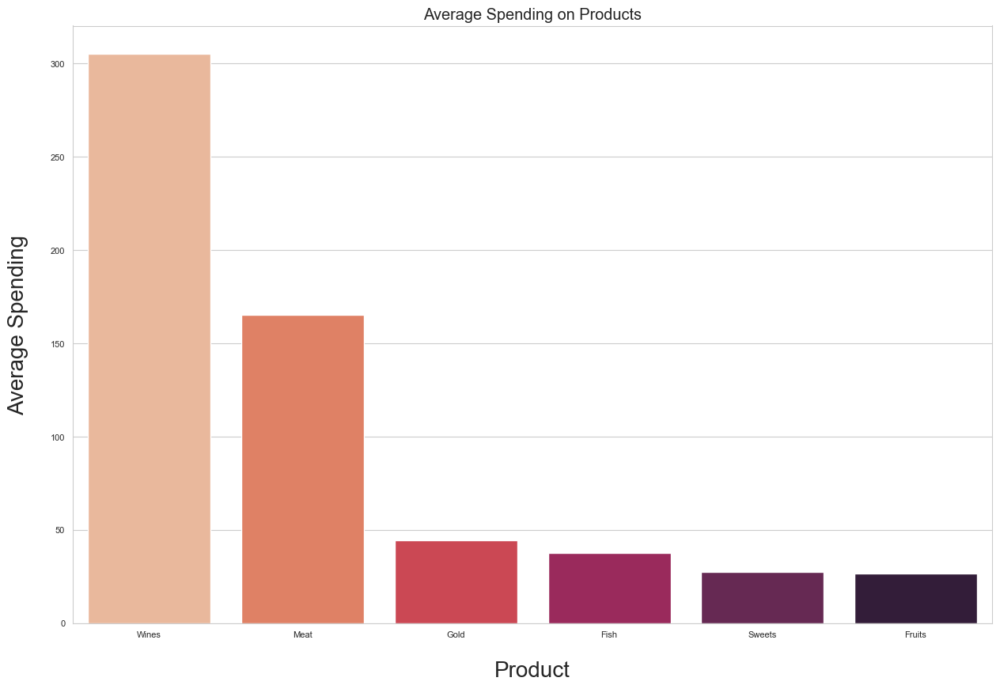

In [70]:
products = df_1[['Wines', 'Fruits', 'Meat', 'Fish', 'Sweets', 'Gold']]
product_means = products.mean(axis=0).sort_values(ascending=False)
product_means_df_1 = pd.DataFrame(list(product_means.items()), columns=['Product', 'Average Spending'])

plt.figure(figsize=(15,10))
plt.title('Average Spending on Products')
sns.barplot(data=product_means_df_1, x='Product', y='Average Spending', palette='rocket_r');
plt.xlabel('Product', fontsize=20, labelpad=20)
plt.ylabel('Average Spending', fontsize=20, labelpad=20);

# 4. Data Pre-processing

In [71]:
#Get list of categorical variables:

s = (df_1.dtypes == 'object')
object_cols = list(s[s].index)

print("Categorical variables in the dataset:", object_cols)

Categorical variables in the dataset: ['Education', 'Marital_Status', 'Living_With', 'AgeGroup']


In [72]:
#Label Encoding the object dtypes.
LE=LabelEncoder()
for i in object_cols:
    df_1[i]= df_1[[i]].apply(LE.fit_transform)
    
print("All features are now numerical")

All features are now numerical


In [73]:
df_1.sample(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,Wines,Fruits,Meat,Fish,Sweets,Gold,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Total_Spent,Living_With,Children,Family_Size,Is_Parent,Join_year,Join_month,Join_weekday,Total_num_purchase,Total_accept,AgeGroup
1393,10909,1948,0,3,92344,0,0,2014-01-15,9,992,24,694,51,19,119,0,5,10,5,1,1,0,1,0,0,0,0,73,1899,1,0,2,0,2014,1,2,21,2,2
1406,10490,1969,1,3,51039,1,1,2012-10-12,11,100,64,79,65,0,109,2,6,2,4,7,0,0,0,0,0,0,0,52,417,1,2,4,1,2012,10,4,21,0,1
2042,9119,1950,0,5,60905,0,1,2013-05-12,27,208,17,76,36,17,38,2,3,3,7,2,0,0,0,0,0,0,0,71,392,1,1,3,1,2013,5,6,17,0,2
945,4843,1952,0,4,75127,0,0,2014-05-22,92,203,35,305,46,17,227,1,2,11,5,1,0,0,0,0,0,0,0,69,833,0,0,1,0,2014,5,3,20,0,2
653,2131,1959,1,2,62859,0,1,2012-12-30,37,1063,89,102,16,12,25,4,9,4,6,6,0,0,0,0,0,0,0,62,1307,0,1,2,1,2012,12,6,29,0,2


In [74]:
join_month_weekday= df_1[['Join_month','Join_weekday','Complain']]
join_month_weekday

,Join_month,Join_weekday,Complain
0,11,4,0
1,2,2,0
2,5,5,0
3,1,2,0
4,6,0,0
5,9,4,0
6,11,0,0
7,5,1,0
8,11,5,0
9,11,3,0


Wine and Meat Products are the most famous products among customers Candy and Fruits are not often bought

In [75]:
df_clust = df_1.drop(['ID', 'Year_Birth', 'Marital_Status', 'Kidhome', 'Teenhome','Dt_Customer', 'Recency', 'NumDealsPurchases', 'NumWebPurchases','NumCatalogPurchases',
                         'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5',
                        'AcceptedCmp1', 'AcceptedCmp2', 'Complain',  'Response','Is_Parent','Join_month','Join_weekday'], axis=1)

In [76]:
df_clust.sample(7)

,Education,Income,Wines,Fruits,Meat,Fish,Sweets,Gold,Age,Total_Spent,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup
1686,0,33228,22,2,31,7,4,5,41,71,1,1,3,2014,13,0,1
901,0,31814,35,3,20,4,1,20,48,83,1,1,3,2013,16,1,1
1593,1,40442,45,12,52,25,22,13,69,169,1,2,4,2012,19,1,2
511,0,27203,13,2,21,4,0,24,71,64,1,2,4,2012,14,0,2
2216,0,36807,4,2,5,0,0,5,67,16,1,2,4,2012,10,0,2
1625,0,69139,86,12,75,33,15,6,56,227,1,1,3,2014,15,0,1
1189,0,28510,44,5,19,0,4,19,40,91,0,2,3,2013,14,0,1


# 5. PCA (Dimensional Reduction)

In [77]:
#Initiating PCA to reduce dimentions aka features to 3
pca = PCA(n_components=3)
pca.fit(df_clust)
PCA_ds = pd.DataFrame(pca.transform(df_clust), columns=(["col1","col2","col3"]))
PCA_ds.describe().T

,count,mean,std,min,25%,50%,75%,max
col1,2229.0,-2.143984e-12,20609.194886,-49889.444503,-16203.771818,-253.979482,16503.036084,62077.967345
col2,2229.0,2.845996e-14,404.862320,-2182.582469,-265.683999,-40.327735,240.638746,2553.160595
col3,2229.0,1.676661e-14,175.533492,-684.539448,-58.356185,8.704798,47.347113,1519.480894


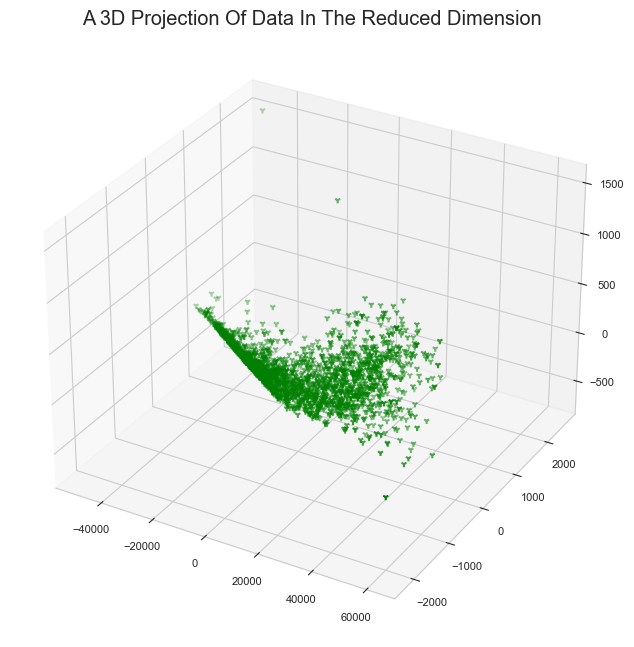

In [78]:
#A 3D Projection Of Data In The Reduced Dimension
x =PCA_ds["col1"]
y =PCA_ds["col2"]
z =PCA_ds["col3"]

#To plot
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111, projection="3d")
ax.scatter(x,y,z, c="green", marker="1") # c="colour of points" and marker = "shape of the points ex: circle,square.etc"
ax.set_title("A 3D Projection Of Data In The Reduced Dimension")
plt.show()

In [79]:

#Ploting result data with the use of scatterplot. plotly
x =PCA_ds["col1"]
y =PCA_ds["col2"]
z =PCA_ds["col3"]

fig = go.Figure(data=[go.Scatter3d(
    x=x,y=y,z=z,mode='markers',
    marker=dict(size=6,color='green',opacity=0.8))])

# tight layout
fig.update_layout( title={'text': "3D scatterplot of size-reduced data",'y':0.9,
        'x':0.5,'xanchor': 'center','yanchor': 'top'},
                  margin=dict(l=200, r=220, b=0, t=0))
fig.show()

In [80]:
#Ploting result data with the use of scatterplot. plotly
x =PCA_ds["col1"]
y =PCA_ds["col2"]
z =PCA_ds["col3"]

 
fig = go.Figure(data=[go.Scatter3d(
    x=x,y=y,z=z,mode='markers',
    marker=dict(size=6,color=x,opacity=0.8))])

# tight layout
fig.update_layout( title={'text': "3D scatterplot of size-reduced data",'y':0.9,
        'x':0.5,'xanchor': 'center','yanchor': 'top'},
                  margin=dict(l=200, r=220, b=0, t=0))
fig.show()

## Elbow method

Elbow Method to determine the number of clusters to be formed:


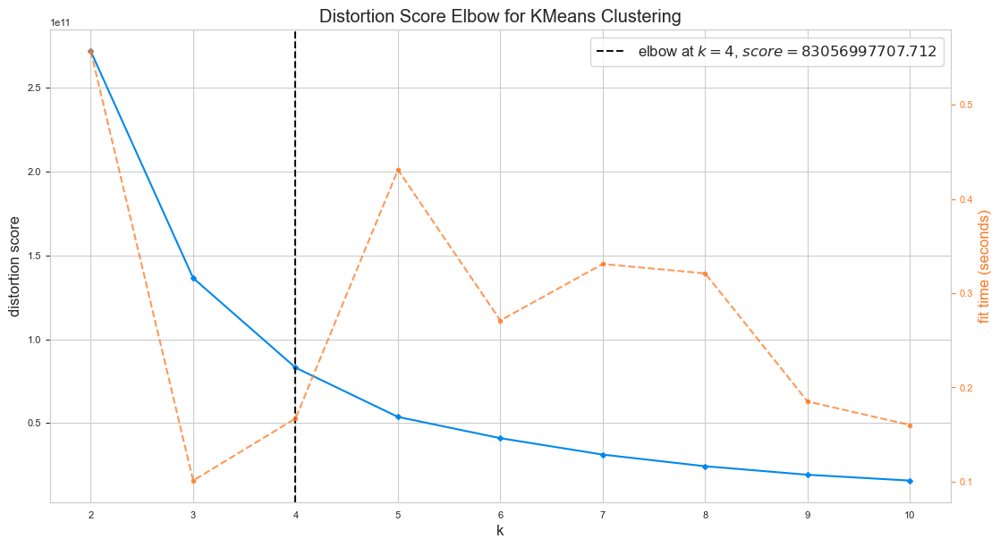

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [81]:
# Elbow method:

fig = plt.figure(figsize=(13,7))
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(KMeans(), k = 10)
Elbow_M.fit(PCA_ds)
Elbow_M.show()

In [82]:
model = KMeans(n_clusters=4, init='k-means++', random_state=42).fit(df_clust)

preds = model.predict(df_clust)

customer_kmeans = df_clust.copy()
customer_kmeans['clusters'] = preds

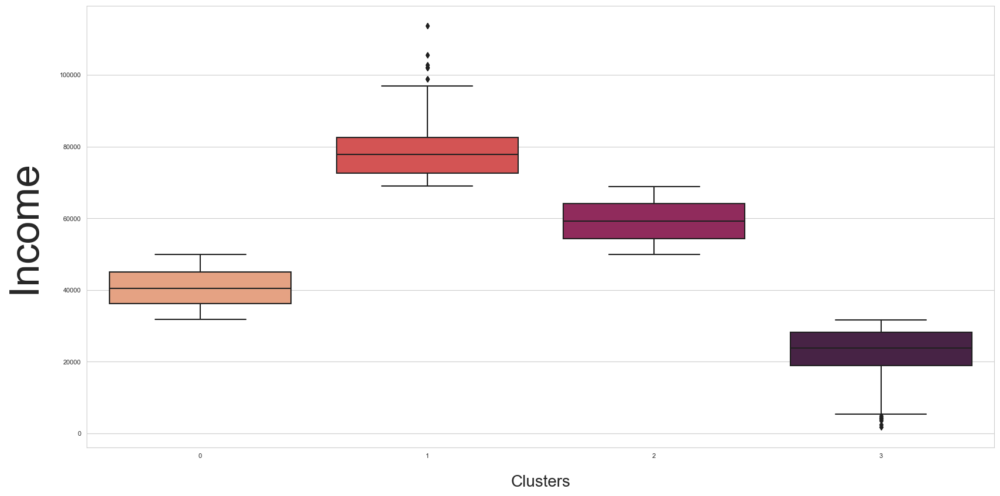

In [83]:
#Income
plt.figure(figsize=(20,10))

sns.boxplot(data=customer_kmeans, x='clusters', y = 'Income',palette='rocket_r');
plt.xlabel('Clusters', fontsize=20, labelpad=20)
plt.ylabel('Income', fontsize=50, labelpad=20);

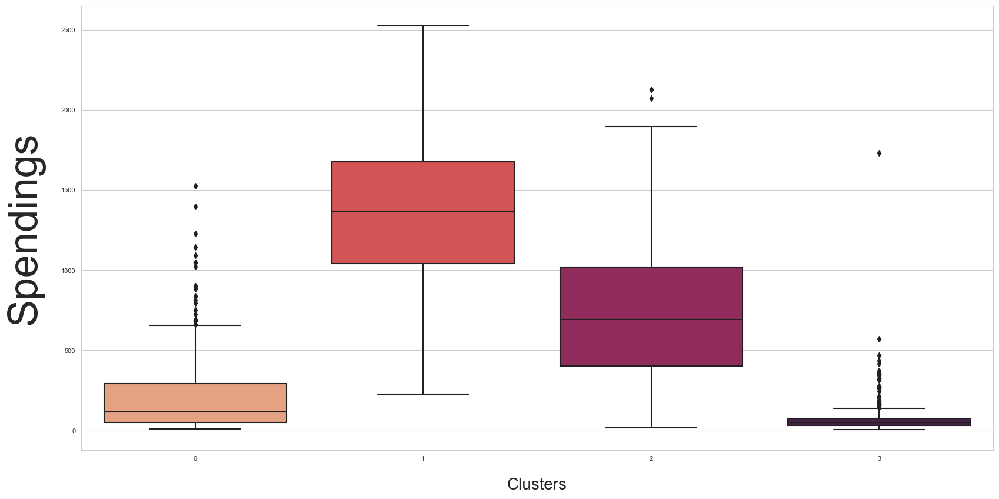

In [84]:
#Total Spending
plt.figure(figsize=(20,10))

sns.boxplot(data=customer_kmeans, x='clusters', y = 'Total_Spent',palette='rocket_r');
plt.xlabel('Clusters', fontsize=20, labelpad=20)
plt.ylabel('Spendings', fontsize=50, labelpad=20);


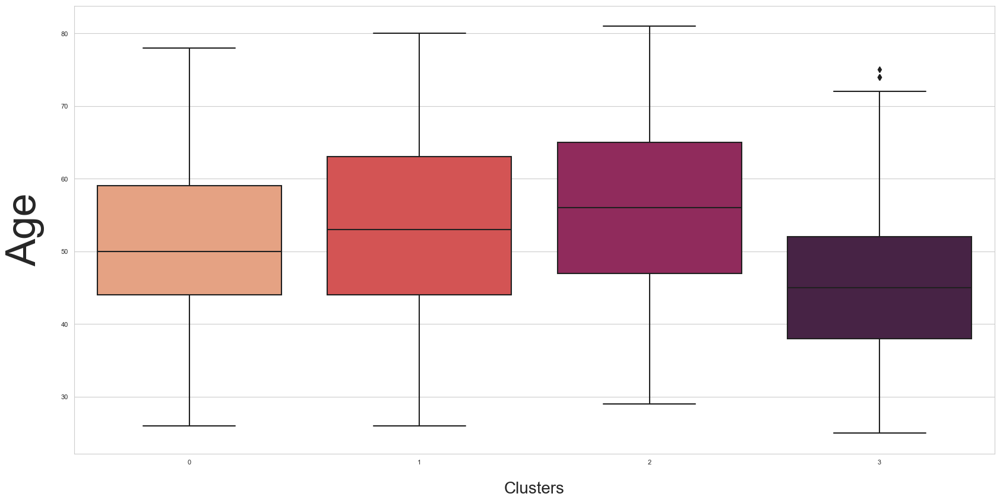

In [85]:
plt.figure(figsize=(20,10))

sns.boxplot(data=customer_kmeans, x='clusters', y = 'Age',palette='rocket_r');
plt.xlabel('Clusters', fontsize=20, labelpad=20)
plt.ylabel('Age', fontsize=50, labelpad=20);

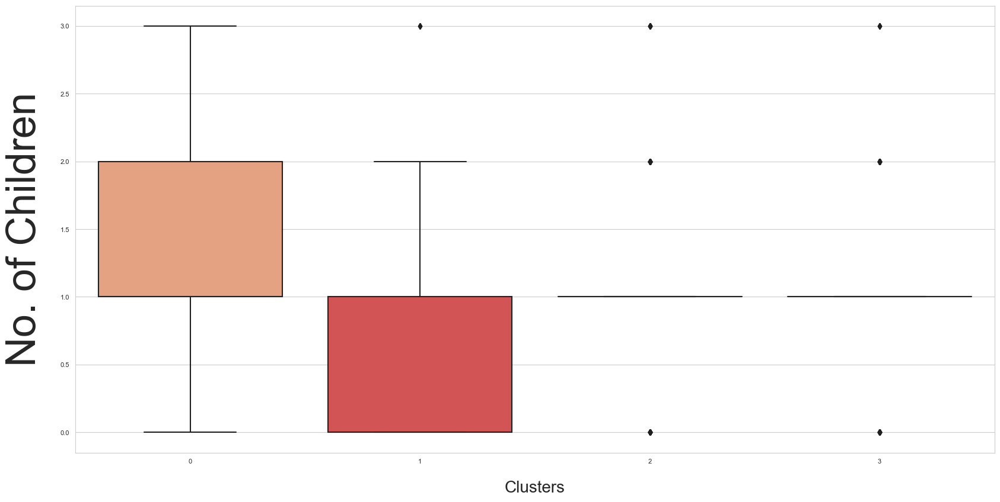

In [86]:
plt.figure(figsize=(20,10))

sns.boxplot(data=customer_kmeans, x='clusters', y = 'Children',palette='rocket_r');
plt.xlabel('Clusters', fontsize=20, labelpad=20)
plt.ylabel('No. of Children', fontsize=50, labelpad=20);


#### From the above analysis we can group customers into 4 groups based on their income and total expenses:

#### Platinum: Highest income and highest expense

#### Gold: High earners and high spenders

#### Silver: The one with lower salary and less expenses

#### Bronze: The one with the lowest salary and least expenses

In [87]:
customer_kmeans.clusters = customer_kmeans.clusters.replace({ 0: 'Platinum',1: 'Bronze',
                                                             2: 'Gold',
                                                             3: 'Silver',
                                                             })

df_clust['clusters'] = customer_kmeans.clusters

In [88]:
cluster_counts = df_clust.clusters.value_counts()

fig = px.pie(cluster_counts, 
             values = cluster_counts.values, 
             names = cluster_counts.index,
             color_discrete_sequence=px.colors.sequential.RdBu)
fig.update_traces(textposition='inside', textinfo='percent+label', textfont_size=20,
                  marker = dict(line = dict(color = 'white', width = 2)))
fig.show()

Most customers are in the Silver and Gold categories, around 29% and 28% respectively
Platinum is the 3rd well-known customer category with 24% while only 19% occupies the bronze category


Relationship: Income vs. Spendings

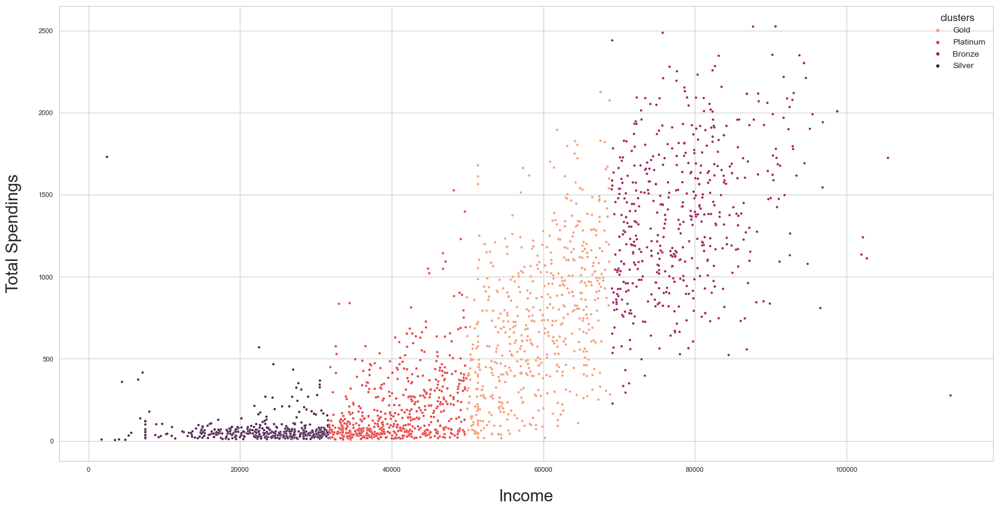

In [89]:
plt.figure(figsize=(20,10))
sns.scatterplot(data=df_clust, x='Income', y='Total_Spent', hue='clusters', palette='rocket_r');
plt.xlabel('Income', fontsize=20, labelpad=20)
plt.ylabel('Total Spendings', fontsize=20, labelpad=20);

4 clusters can be easily identified from the plot above
Those who earn more also spend more

Spending Habits by Clusters

In [90]:
df_clust.sample(3)

,Education,Income,Wines,Fruits,Meat,Fish,Sweets,Gold,Age,Total_Spent,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,clusters
1741,2,75342,204,97,97,21,118,26,63,563,0,1,2,2013,22,0,2,Bronze
820,0,72504,604,26,470,123,161,94,49,1478,0,1,2,2013,24,0,1,Bronze
1688,0,38232,43,5,28,7,6,33,50,122,1,2,4,2014,16,0,1,Platinum


In [91]:
customer_kmeans.clusters = df_clust.clusters.replace({'Platinum':0, 'Gold':1,'Silver':2,'Bronze':3})

df_clust['Clusters'] = customer_kmeans.clusters

In [92]:
df_1.sample(5)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,Wines,Fruits,Meat,Fish,Sweets,Gold,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Total_Spent,Living_With,Children,Family_Size,Is_Parent,Join_year,Join_month,Join_weekday,Total_num_purchase,Total_accept,AgeGroup
1656,7485,1950,1,6,56551,1,1,2014-07-05,48,67,4,32,17,2,16,3,2,1,4,4,0,0,0,0,0,0,0,71,138,0,2,3,1,2014,7,5,14,0,2
947,1628,1971,0,5,71796,0,0,2013-10-24,54,354,21,311,167,75,32,1,9,3,4,4,0,0,0,0,0,0,0,50,960,1,0,2,0,2013,10,3,21,0,1
161,5885,1973,2,3,35688,2,1,2012-08-22,94,73,3,90,12,1,32,7,4,1,4,8,0,0,0,0,0,0,0,48,211,1,3,5,1,2012,8,2,24,0,1
1066,7290,1985,0,4,70596,0,0,2012-05-10,68,347,44,534,17,0,26,1,3,5,12,2,0,0,0,0,0,0,0,36,968,0,0,1,0,2012,5,3,23,0,0
1215,2995,1957,1,5,66636,0,0,2013-08-17,64,291,10,689,84,10,0,1,3,4,9,1,0,0,0,0,0,0,0,64,1084,1,0,2,0,2013,8,5,18,0,2


In [93]:
df_clust.sample(5)

,Education,Income,Wines,Fruits,Meat,Fish,Sweets,Gold,Age,Total_Spent,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,clusters,Clusters
193,1,51650,152,3,22,2,5,7,45,191,1,1,3,2014,15,0,1,Gold,1
750,0,62882,509,133,497,78,24,97,52,1338,1,1,3,2012,24,0,1,Gold,1
989,0,35704,30,9,12,2,11,30,69,94,1,2,4,2014,13,0,2,Platinum,0
1734,2,23529,9,7,13,3,2,20,56,54,0,1,2,2013,11,0,1,Silver,2
151,1,35860,15,0,8,4,2,20,48,49,0,2,3,2014,11,2,1,Platinum,0


In [94]:
final = df_clust.drop(['Wines','Fruits','Meat','Fish','Sweets','Gold','Age','clusters'],axis = 1)

In [95]:
final.sample(3)

,Education,Income,Total_Spent,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,Clusters
102,0,81361,778,0,0,1,2014,28,0,0,3
812,0,46984,41,0,2,3,2013,10,0,2,0
347,0,75693,1442,0,0,1,2012,26,4,1,3


In [96]:
final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2229 entries, 0 to 2239
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype
---  ------              --------------  -----
 0   Education           2229 non-null   int32
 1   Income              2229 non-null   int64
 2   Total_Spent         2229 non-null   int64
 3   Living_With         2229 non-null   int32
 4   Children            2229 non-null   int64
 5   Family_Size         2229 non-null   int64
 6   Join_year           2229 non-null   int64
 7   Total_num_purchase  2229 non-null   int64
 8   Total_accept        2229 non-null   int64
 9   AgeGroup            2229 non-null   int32
 10  Clusters            2229 non-null   int64
dtypes: int32(3), int64(8)
memory usage: 182.8 KB


In [97]:

final=final.assign(Incomes=pd.cut(final['Income'], 
                               bins=[ 0, 25000, 50000,100000,666666], 
                               labels=['Below 25000', 'Income 25000-50000 ', 'Income 50000-100000 ','Above 100000']))
final=final.drop("Income", axis=1)

In [98]:

final=final.assign(Expense=pd.cut(final['Total_Spent'], 
                               bins=[ 0, 500, 1000, 2525], 
                               labels=['Below 500', 'Expense 500-1000 ','Above 1000']))
final=final.drop("Total_Spent", axis=1)

In [99]:
final.sample(5)

,Education,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,Clusters,Incomes,Expense
949,0,0,1,2,2013,31,0,1,1,Income 50000-100000,Expense 500-1000
1098,1,1,0,2,2013,27,7,2,3,Income 50000-100000,Expense 500-1000
1597,1,1,1,3,2012,18,0,1,2,Income 25000-50000,Below 500
133,2,1,2,4,2013,12,0,1,2,Income 25000-50000,Below 500
1444,2,1,0,2,2013,11,0,0,2,Below 25000,Below 500


In [100]:
# Label Encoding:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()

In [101]:
final['Incomes']= label_encoder.fit_transform(final['Incomes'])
# final['DOB']= label_encoder.fit_transform(final['DOB'])
final['Expense']= label_encoder.fit_transform(final['Expense'])

In [102]:
from sklearn.preprocessing import normalize
final_scaled = normalize(final)
final_scaled = pd.DataFrame(final_scaled, columns=final.columns)
final_scaled.sample(5)

,Education,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,Clusters,Incomes,Expense
929,0.000497,0.000497,0.000000,0.000994,0.999927,0.011928,0.0,0.000497,0.000994,0.000497,0.000497
1420,0.000993,0.000000,0.000000,0.000497,0.999926,0.011922,0.0,0.000497,0.000497,0.001490,0.000993
1122,0.000994,0.000497,0.000000,0.000994,0.999974,0.006955,0.0,0.000497,0.000994,0.000497,0.000497
1759,0.000994,0.000000,0.000497,0.000994,0.999974,0.006955,0.0,0.000497,0.000994,0.000497,0.000497
813,0.000000,0.000000,0.000497,0.000993,0.999926,0.011922,0.0,0.000497,0.001490,0.001490,0.000000


In [103]:
#Initiating PCA to reduce dimentions aka features to 3
pca = PCA(n_components=3)
pca.fit(final_scaled)
PCA_ds = pd.DataFrame(pca.transform(final_scaled), columns=(["col1","col2","col3"]))
PCA_ds.describe().T

,count,mean,std,min,25%,50%,75%,max
col1,2229.0,6.400149e-19,0.003601,-0.009490,-0.003103,-0.000508,0.002449,0.012764
col2,2229.0,1.260768e-19,0.000704,-0.001767,-0.000523,-0.000092,0.000456,0.002485
col3,2229.0,-1.063287e-19,0.000457,-0.000901,-0.000314,-0.000054,0.000245,0.002884


# 6. Model Building

In [104]:
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering


In [105]:
hc=AgglomerativeClustering(n_clusters=4,affinity='euclidean',linkage="ward") 

In [106]:
y_hc=hc.fit_predict(final_scaled)
clusters=pd.DataFrame(y_hc,columns=['Clusters'])

In [107]:
y_hc

array([1, 0, 1, ..., 3, 3, 2], dtype=int64)

In [108]:
clusters.sample(10)

,Clusters
2038,2
1756,1
583,2
1959,2
1193,1
958,1
481,1
259,0
436,0
390,3


In [109]:
final.sample(3)

,Education,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,Clusters,Incomes,Expense
1247,1,1,1,3,2014,11,0,2,1,3,1
388,0,0,1,2,2012,13,0,0,2,2,1
872,1,1,2,4,2014,25,0,1,0,2,1


In [110]:
final.shape

(2229, 11)

In [111]:
X = final.drop("Clusters", axis=1)
Y = final.Clusters
X.shape, Y.shape

((2229, 10), (2229,))

In [112]:
X.sample(5)

,Education,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,Incomes,Expense
1138,0,1,3,5,2014,10,0,1,2,1
1307,1,1,1,3,2013,14,0,1,2,1
2050,1,1,1,3,2013,11,0,1,2,1
1716,1,1,1,3,2014,15,0,1,3,1
1251,2,0,1,2,2014,12,0,0,2,1


In [113]:
Y.sample(8)

1320    1
1942    0
754     0
974     0
623     2
1409    0
724     1
1580    2
Name: Clusters, dtype: int64

In [114]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X,Y, test_size = 0.3, random_state = 10)


In [115]:
x_train.shape, y_train.shape, x_test.shape, y_test.shape

((1560, 10), (1560,), (669, 10), (669,))

## Random Forest Classifier

In [116]:
from sklearn.ensemble import RandomForestClassifier 
model = RandomForestClassifier(max_depth=4, random_state = 10) 
model.fit(x_train, y_train)

RandomForestClassifier(max_depth=4, random_state=10)

In [117]:
x_train.shape

(1560, 10)

In [118]:
x_test.shape

(669, 10)

In [119]:
from sklearn.metrics import accuracy_score
pred_cv = model.predict(x_test)
accuracy_score(y_test,pred_cv)*100

80.71748878923766

In [120]:
pred_train = model.predict(x_train)
accuracy_score(y_train,pred_train)*100

80.32051282051282

In [121]:
# saving the model 
import pickle 
pickle_out = open("RFC_model_1.pkl", mode = "wb") 
pickle.dump(model, pickle_out) 
pickle_out.close()

In [122]:
x_train.head()

,Education,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,Incomes,Expense
710,0,1,0,2,2014,32,1,2,3,0
1761,0,0,2,3,2012,15,0,1,2,1
1728,1,1,0,2,2013,28,4,0,3,0
1121,0,0,0,1,2013,17,0,2,3,0
125,0,1,1,3,2013,27,0,1,3,2


In [123]:
final['AgeGroup'].max()

3

In [124]:
df_1["AgeGroup"].value_counts()

1    1233
2     615
0     345
3      36
Name: AgeGroup, dtype: int64

In [125]:
final['Total_num_purchase'].max()

46

In [126]:
df_clust["Total_num_purchase"].value_counts()

12    140
14    136
13    125
24    114
15    106
16    103
11    102
18     99
23     98
19     96
20     94
25     93
28     93
26     90
21     90
17     90
22     73
10     65
30     61
27     56
29     48
31     42
9      35
32     34
34     29
33     27
35     18
38     15
8      13
37     11
36      9
39      9
7       6
40      3
41      2
44      1
1       1
6       1
46      1
Name: Total_num_purchase, dtype: int64

In [127]:
final['Expense'].max()

2

In [128]:
final['Expense'].max()

2

In [129]:
final["Expense"].value_counts()

1    1239
0     598
2     392
Name: Expense, dtype: int64

In [130]:
counts = final.nunique()
counts

Education              3
Living_With            2
Children               4
Family_Size            5
Join_year              3
Total_num_purchase    39
Total_accept           8
AgeGroup               4
Clusters               4
Incomes                4
Expense                3
dtype: int64

In [131]:
final.sample(10)

,Education,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,Clusters,Incomes,Expense
838,0,0,3,4,2013,14,0,1,0,2,1
124,1,1,0,2,2012,16,0,2,3,3,2
1026,1,1,0,2,2014,18,0,2,1,3,1
971,0,0,1,2,2012,28,0,1,3,3,0
2144,0,1,0,2,2014,13,0,2,2,1,1
842,0,0,0,1,2012,24,0,0,0,2,2
1659,0,0,2,3,2012,18,1,1,0,2,1
964,1,0,2,3,2013,15,0,1,0,2,1
126,1,0,0,1,2012,26,2,0,1,3,0
1726,1,1,1,3,2012,31,2,1,1,3,2


In [132]:
final.shape

(2229, 11)

In [133]:
join_month_weekday.shape

(2229, 3)

In [134]:
customers = pd.merge(final,join_month_weekday,left_index=True,right_index=True)
customers

,Education,Living_With,Children,Family_Size,Join_year,Total_num_purchase,Total_accept,AgeGroup,Clusters,Incomes,Expense,Join_month,Join_weekday,Complain
0,0,1,1,3,2013,11,0,0,1,3,1,11,4,0
1,0,0,1,2,2013,28,0,0,1,3,2,2,2,0
2,1,0,0,1,2013,11,0,2,1,3,1,5,5,0
3,0,0,3,4,2014,16,0,2,1,3,1,1,2,0
4,0,0,1,2,2013,13,0,0,1,3,1,6,0,0
5,2,1,1,3,2012,17,0,1,1,3,1,9,4,0
6,1,1,3,5,2012,38,0,2,1,3,2,11,0,0
7,0,0,2,3,2014,11,0,2,1,3,1,5,1,0
8,1,1,0,2,2013,16,0,1,1,3,2,11,5,0
9,1,1,1,3,2013,23,0,3,1,3,1,11,3,0


In [135]:
customers["Complain"].value_counts()

0    2209
1      20
Name: Complain, dtype: int64

In [136]:
# saving the model 
import pickle 
pickle_out = open("customers.pkl", mode = "wb") 
pickle.dump(customers, pickle_out) 
pickle_out.close()

                                    Deployment Streamlit code is in Deployment File 
                             